# Choropleth Low-Level Arrests at the Census Block Level

In [64]:
import pandas as pd
import geopandas as gpd
import contextily as ctx
import matplotlib.pyplot as plt
import plotly.express as px
import plotly as plot
import numpy as np
import matplotlib as mpl
import requests

In [65]:
blocks = gpd.read_file('Census_Block_Groups_2020.geojson')
hoods = gpd.read_file('LA_Times_Neighborhood_Boundaries.geojson')

In [66]:
blocks.columns = ['ID','Block Number','Tract','Label','Area','Length','geometry']

In [67]:
arrests1 = pd.read_csv('Arrest_Data_from_2010_to_2019 (1).csv')

Pulled from LAPD Arrest Data - This is for 2017-2023 (per discussion about moving demographic timeline back) 

In [68]:
arrests1 = arrests1[arrests1['Descent Code'] == "B"]

In [69]:
arrests1 = arrests1[[
    'Area Name','Age','Sex Code','Descent Code','Charge Description','LAT','LON','Location']]

In [70]:
df = arrests1

In [71]:
gdf = gpd.GeoDataFrame(
    df, geometry=gpd.points_from_xy(df.LON, df.LAT))

gdf = gdf[['Area Name','Age','Descent Code','Sex Code','Charge Description','LAT','LON','geometry']]

gdf = gdf.set_crs('epsg:4326')

In [72]:
join = gpd.sjoin(gdf,blocks, how="right", predicate="within")

arrests1 = join

In [73]:
arrests1 = arrests1.dropna(subset=['LAT'])

In [74]:
counts = arrests1.groupby('Block Number').size()

In [75]:
counts.value_counts

<bound method IndexOpsMixin.value_counts of Block Number
1011102      4
1011103      2
1012202      1
1012211      4
1012212      1
          ... 
9800221      8
9800241     47
9800281    860
9800311     61
9800391      8
Length: 2194, dtype: int64>

In [76]:
counts.columns = ['Block Group','Arrests']

In [87]:
df = pd.DataFrame({'Block Group':counts.index, 'Arrests':counts.values})

In [88]:
df= blocks.merge(df, left_on="Block Number",right_on="Block Group", how="outer") 

In [89]:
df =df.dropna()

In [90]:
df.shape

(2194, 9)

In [91]:
fig = px.choropleth_mapbox(df, geojson=df.geometry, locations=df.index, color='Arrests',
                           mapbox_style="carto-positron",
                           range_color=(1, 50),
                           zoom=9.15, 
                           center = {"lat": 34.02, "lon": -118.38411},
                           opacity=0.75,
                           hover_name = 'Block Number')

In [92]:
hoods.index = hoods['name']
fig2 = px.choropleth_mapbox(hoods, geojson=hoods.geometry,locations = hoods.index,
                           color_continuous_scale="viridis",
                           mapbox_style="carto-positron",
                           zoom=9.15, center = {"lat": 34.02, "lon": -118.38411},
                           opacity=0.10,)

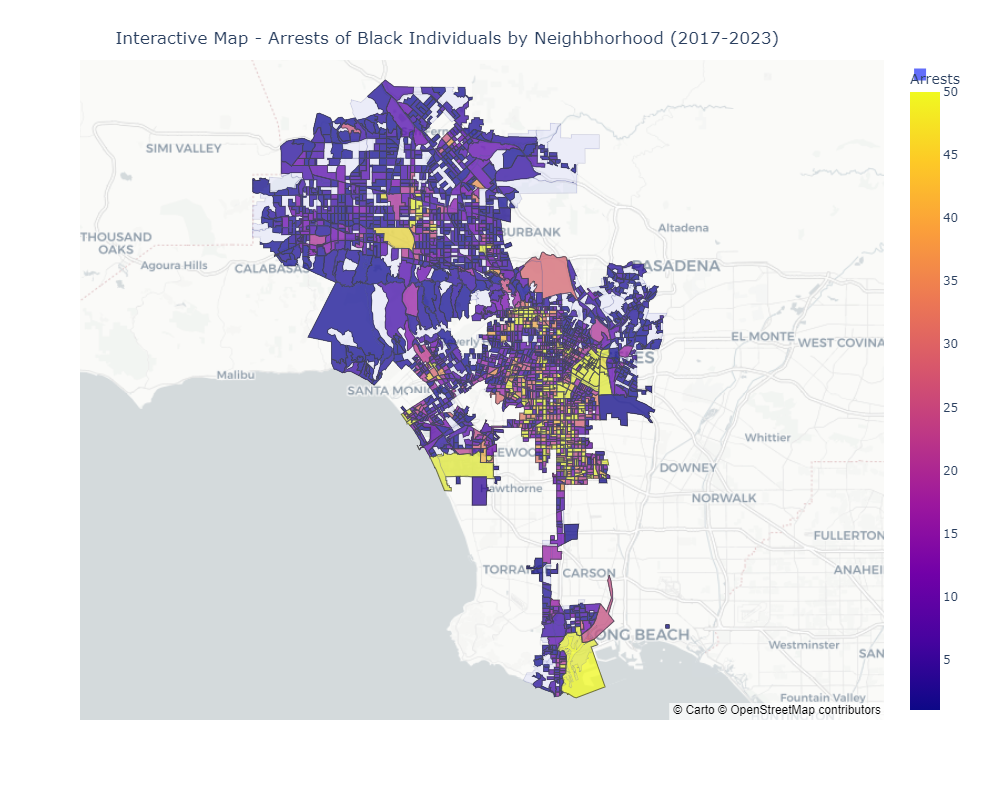

In [93]:
arrest_map = fig.add_trace(
     fig2.data[0])

arrest_map.update_layout(
    width = 1200,
    height = 800,
    title = "Interactive Map - Arrests of Black Individuals by Neighbhorhood (2017-2023) ",
    title_y=.96,
    title_x=0.455,
) 

So this is the final choropleth I got, there were a bunch of null values that I could not figure out.  I think this could be there were zero arrests in the Census Block.  Not sure how this is possible but that's what got spit out.  I am pretty unfamiliar with tweaking the colors of the maps (making the neighborhood boundary lines a different color for example). This doesn't look great but at least what it does is show the name of the area when you hover over it. I will try to play around with it more but wanted to pass along.  